In [2]:
import msicpe.ssl as ssl
import plotly.express as px
import numpy as np 
import sounddevice as sd
import matplotlib.pyplot as plt
import scipy.io as io

------  Parlez !!!  ------
------  STOP !!!  ------
Lecture de l'enregistrement...


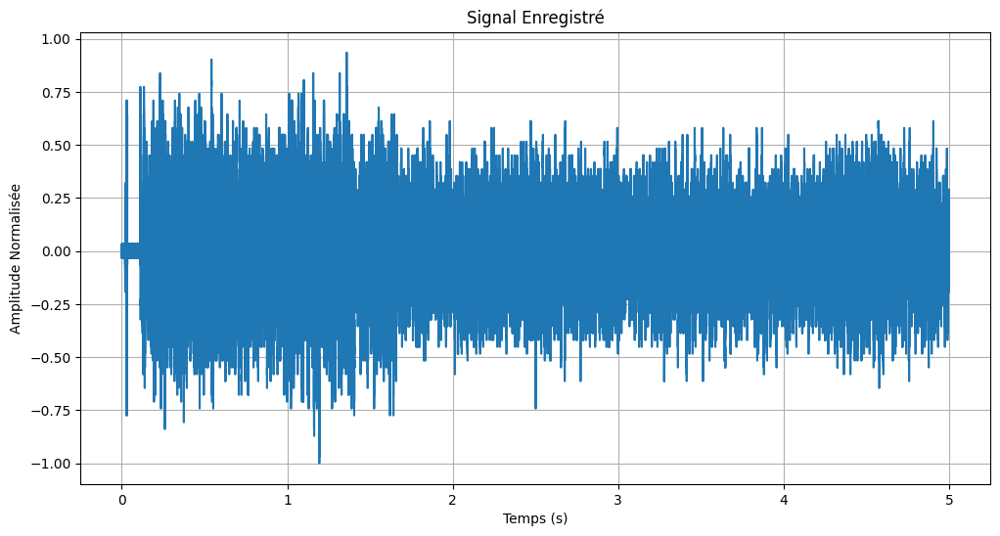

Enregistrement sauvegardé sous son0.wav


In [3]:
choices, signal, t = ssl.RecordModulation(96000, 5)

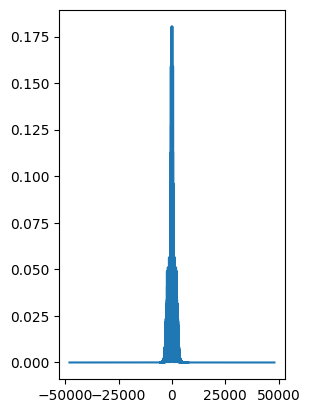

"\n# Affichage avec DataFrame : \ndf_choices = pd.DataFrame({  'temps':t, 'amplitude':signal   }) \n\n\nfig2 = px.line(df_choices, x='temps', y='amplitude', labels={'temps':'Temps (s)',\n        'amplitude':''}, title='Signal en fonction du temps (5sec)', width=700)\nfig2.show()\n"

In [4]:
# PARTIE TRANSMISSION 

import pandas as pd 

"Filtre Passe-Bas"

Fe = 96000
Fc = 3000
signal, _ = ssl.audioread("choices.wav", False)
signal_filtre = ssl.PasseBas(signal, Fe, Fc)

TF_filtre, F = ssl.TransFourier(signal_filtre, t)
TF_filtre_module = np.abs(TF_filtre)

# affichage 
plt.subplot(1,2,1)
# plt.plot( F, np.imag(TF_filtre) )
# plt.plot( F, np.real(TF_filtre) )
plt.plot( F, TF_filtre_module )
plt.show()

"""
# Affichage avec DataFrame : 
df_choices = pd.DataFrame({  'temps':t, 'amplitude':signal   }) 


fig2 = px.line(df_choices, x='temps', y='amplitude', labels={'temps':'Temps (s)',
        'amplitude':''}, title='Signal en fonction du temps (5sec)', width=700)
fig2.show()
""" 

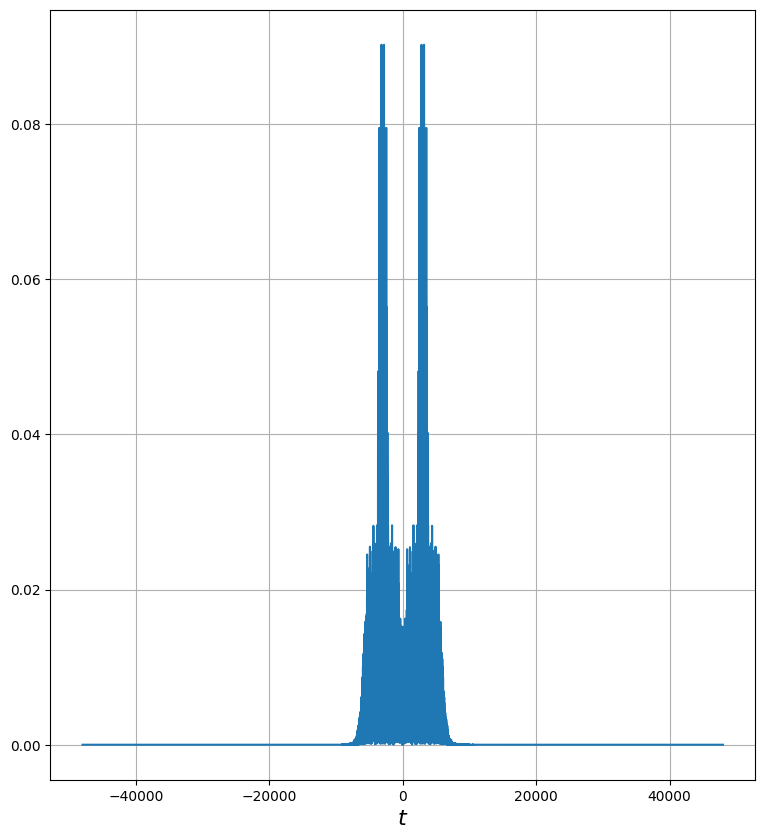

In [5]:
"Modulation"

Vp = 1
Fp = 3000
omega_p = 2*np.pi*Fp

signal_module = signal_filtre * Vp * np.cos(omega_p * t)

Tf_module, Fm = ssl.TransFourier(signal_module, t)
Tf_module_module = np.abs(Tf_module)

plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.plot( Fm, Tf_module_module )
plt.grid()
plt.xlabel('$t$',fontsize=16,style='italic')
plt.show()


dic = {'signal':signal_module, 'label': 'signal_fp_xkHZ'} 
io.savemat ('sig_multiplen.mat' ,dic)

In [6]:
# PARTIE RECPETION 

Vp = 1
f_p = 3000
omega_p = 2*np.pi*f_p
Fe = 96000
Fc = 3000
t = np.linspace(0, 5, len(signal_module))
sdm = signal_module*Vp*np.cos(omega_p*t)
S = ssl.PasseBas(sdm,Fe,Fc)
sd.play(S, Fe)


df = pd.DataFrame({'Arg1':t, 'Arg2':S})
fig = px.line(df, x='Arg1', y='Arg2')
fig.update_layout(xaxis_title='Amplitude Normalisée', yaxis_title='Temps (s)',
            title = 'signal reçu',
            template='plotly_white', width=500, height=300)

fig.show()

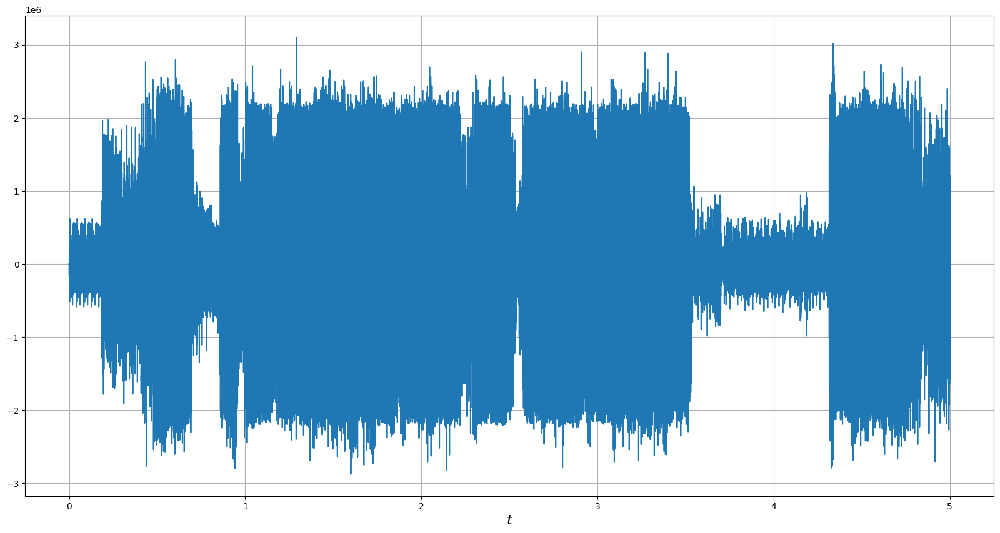

In [7]:
import matplotlib.pyplot as plt

"Passe-Bas"

sdm_filtre = 3000000*ssl.PasseBas(sdm, Fe, Fc)
             #960000


TF_filtre, F = ssl.TransFourier(sdm_filtre, t)

TF_filtre_module = np.abs(TF_filtre)

# Affichage
plt.figure(figsize=(20,10))
plt.plot( t, sdm_filtre )
plt.grid()
plt.xlabel('$t$',fontsize=16,style='italic')
plt.show()

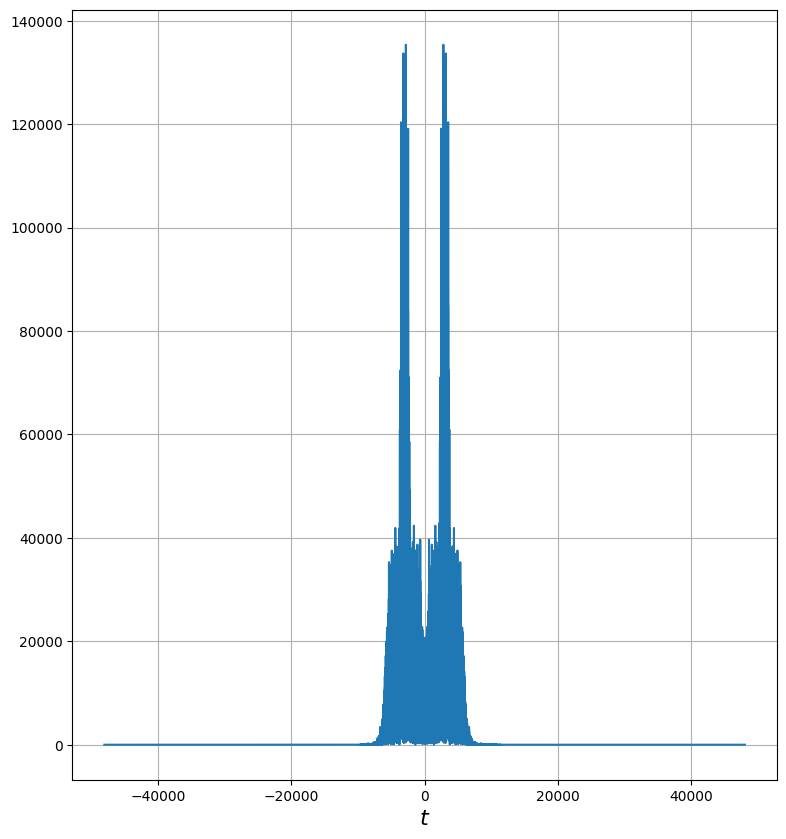

In [8]:
signal_demodule = sdm_filtre * Vp * np.cos(omega_p * t)

Tf_demodule, Fdm = ssl.TransFourier(signal_demodule, t)
Tf_demodule_module = np.abs(Tf_demodule)

plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.plot( Fdm, Tf_demodule_module )
plt.grid()
plt.xlabel('$t$',fontsize=16,style='italic')
plt.show() 

In [9]:
sd.play( signal_demodule , Fe)